In [294]:
import numpy as np
import trimesh
import networkx as nx
import scipy
import matplotlib.pyplot as plt
import robust_laplacian
from mesh_dataset_utils import *

In [295]:
mesh1 = trimesh.load(f'meshes/Spikeyball1.stl')
mesh1.show()

In [296]:
dataset, smooth = build_offset_dataset(mesh1, smooth_iter = 20000, lap_type = 'mesh', smooth_type = 'taubin')
smooth.show()

In [297]:
blankdataset = build_blank_dataset(smooth, "spikeboi1")

In [298]:
import os
import torch
from MLP import MLP

In [299]:
traindatax = torch.Tensor(dataset["fourier"]).float()
traindatay = torch.Tensor(dataset["target"]).float()

In [300]:
model = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=True,
    all_sine=True,
    skip=True,
    bn=True,
    dropout=0.0

)

In [301]:
trainingDataset = torch.utils.data.TensorDataset(traindatax, traindatay)

In [302]:
trainingLoad = torch.utils.data.DataLoader(trainingDataset, batch_size = 1000, shuffle = True)

lossfunc = torch.nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), .0001)

In [303]:
all_predictions = []
all_batches = []

In [304]:
for i in range(10):
    for batch in trainingLoad:
        
        optimizer.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model(Xbatch)
        #print(predicts)
        
        if i == 9:
            for a in predicts:
                print(a)
                all_predictions.append(a.detach().numpy())
                
            all_batches.append(Ybatch.detach().numpy())
        
        error = lossfunc(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer.step()

1.0031134
0.98068935
0.9851611
0.9860807
0.9846291
0.9410745
0.97026163
0.9707444
0.92982244
0.93160874
0.8990391
0.9045918
0.9194339
0.87470394
0.90576744
0.8868949
0.8643919
0.87369806
0.8405359
0.8547267
0.8538406
0.81209165
0.8619351
0.8285409
0.80524856
0.779177
0.80843025
0.79564625
0.7604717
0.7582313
0.79281276
0.76573867
0.7971808
0.71939665
0.7393712
0.6525149
0.7437892
0.73057896
0.689471
0.6593619
0.6707091
0.70902467
0.66419995
0.6979212
0.7468796
0.65470076
0.7160376
0.6787641
0.62116665
0.6474279
0.6696042
0.60434073
0.64230305
0.6568771
0.67900616
0.601871
0.6115891
0.5868064
0.5923333
0.58644456
0.5881464
0.5550254
0.5965778
0.52704585
0.5986004
0.6092752
0.5820301
0.5399399
0.51909393
0.5070344
0.5372774
0.5224845
0.49382195
0.5271235
0.52202916
0.4821245
0.50808007
0.42743936
0.46827894
0.49741122
0.43423998
0.4992999
0.43147543
0.4696351
0.53085923
0.45506075
0.42992076
0.4447622
0.44848052
0.48821673
0.4279157
0.41923112
0.40283692
0.3981156
0.44084692
0.40918696
0

42787
(42787, 3)
42787


Text(0, 0.5, 'Predictions')

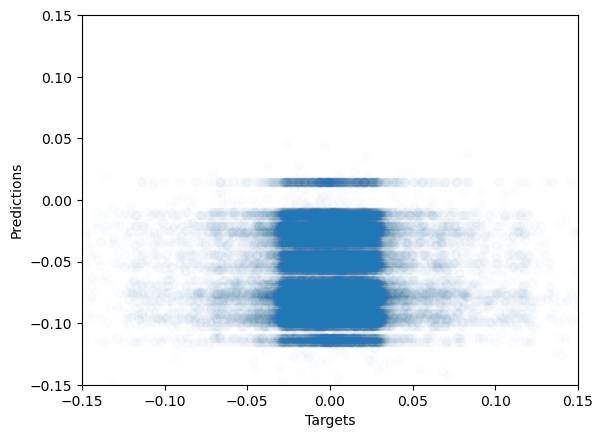

In [305]:
all_batches_fix = []
for i in all_batches:
    for j in i:
        all_batches_fix.append(j)

all_targets_x = [yuh[0] for yuh in all_batches_fix]
#print(all_batches)
print(len(all_targets_x))
all_predictions_x = [yuh[0] for yuh in all_predictions]
print(np.array(all_predictions).shape)
print(len(all_predictions_x))
plt.scatter(all_targets_x, all_predictions_x, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

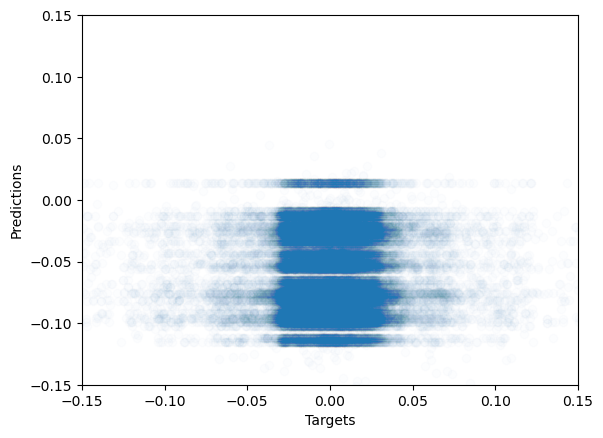

In [306]:
all_targets_y = [yuh[1] for yuh in all_batches_fix]
print(len(all_targets_y))
all_predictions_y = [yuh[1] for yuh in all_predictions]
print(len(all_predictions_y))
plt.scatter(all_targets_y, all_predictions_y, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

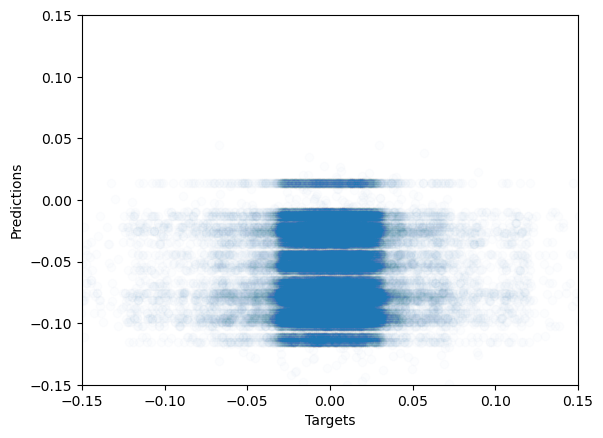

In [307]:
all_targets_z = [yuh[2] for yuh in all_batches_fix]
print(len(all_targets_z))
all_predictions_z = [yuh[2] for yuh in all_predictions]
print(len(all_predictions_z))
plt.scatter(all_targets_z, all_predictions_z, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [311]:
ball = get_sphere(3)
blankdataset = build_blank_dataset(ball, "softboi1")

testDataset = np.load(os.getcwd() + "/softboi1/npz_files/softboi1.npz")
xtestDataset = testDataset["fourier"]

predicts = model(torch.Tensor(xtestDataset).float())
predicts[:50]

tensor([[-0.0379, -0.0377, -0.0377],
        [-0.0635, -0.0633, -0.0634],
        [-0.0826, -0.0821, -0.0823],
        [-0.0290, -0.0290, -0.0291],
        [-0.0769, -0.0776, -0.0775],
        [-0.0897, -0.0896, -0.0892],
        [-0.0294, -0.0295, -0.0295],
        [-0.0826, -0.0824, -0.0827],
        [-0.0395, -0.0396, -0.0398],
        [-0.0711, -0.0711, -0.0708],
        [-0.0133, -0.0136, -0.0133],
        [-0.1331, -0.1334, -0.1325],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
        [-0.0400, -0.0398, -0.0400],
 

In [312]:
yuh = generate_pred_mesh(predicts.detach().numpy(), ball)
yuh.show()

In [313]:
model2 = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=False,
    all_sine=False,
    skip=True,
    bn=True,
    dropout=0.0

)

In [314]:
trainingLoad = torch.utils.data.DataLoader(trainingDataset, batch_size = 1000, shuffle = True)

lossfunc = torch.nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), .0001)

In [315]:
all_predictions2 = []
all_batches2 = []

In [316]:
for i in range(10):
    for batch in trainingLoad:
        
        optimizer.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model2(Xbatch)
        #print(predicts)
        
        if i == 9:
            for a in predicts:
                print(a)
                all_predictions2.append(a.detach().numpy())
                
            all_batches2.append(Ybatch.detach().numpy())
        
        error = lossfunc(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer.step()

1.0019835
1.0006917
1.0001513
1.0025867
0.9999281
0.99997616
0.9998924
1.0027751
1.0007406
1.0035021
1.0008107
1.0007648
1.0001235
1.0003648
1.0010352
1.001793
1.0009197
0.99970526
1.0011923
1.0002333
0.99943984
1.000394
1.0016285
1.0011446
0.99948
1.002064
1.0005879
1.0030783
1.0009139
1.0010066
1.0001293
1.001007
1.0024854
1.0011892
1.0018555
1.0006862
1.0025147
1.0019301
1.0015748
0.99958277
0.99995494
1.0011818
1.0020307
1.0002546
1.0017627
1.0018065
1.0023013
1.0013238
0.9993476
1.0006675
1.0026716
1.0007849
1.0004781
1.0012827
1.0024273
1.0008444
1.0025849
0.9994723
1.0011464
1.0014298
0.9999212
1.0008754
1.0013877
1.0020236
0.99968565
0.99940443
1.0012884
1.0011263
1.0014955
1.0007234
1.0015928
1.001197
1.0010825
1.0015277
1.0013217
1.0013064
1.0005151
1.0021186
1.0009809
1.0012054
1.0007579
0.9992765
1.0003456
1.0016413
1.0005337
1.0008602
1.0029387
1.0015135
0.99929386
1.0003746
1.0025082
1.0014747
1.0007898
1.0009589
0.9993173
1.0022906
1.0027636
1.0000448
1.0008494
1.0022438

42787
(42787, 3)
42787


Text(0, 0.5, 'Predictions')

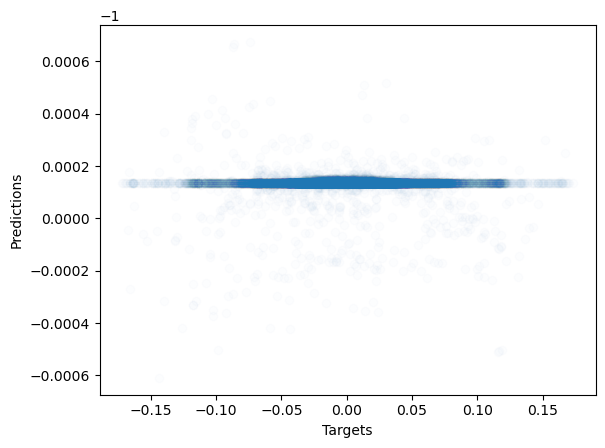

In [317]:
all_batches_fix2 = []
for i in all_batches2:
    for j in i:
        all_batches_fix2.append(j)

all_targets_x2 = [yuh[0] for yuh in all_batches_fix2]
#print(all_batches)
print(len(all_targets_x2))
all_predictions_x2 = [yuh[0] for yuh in all_predictions2]
print(np.array(all_predictions2).shape)
print(len(all_predictions_x2))
plt.scatter(all_targets_x2, all_predictions_x2, alpha = 0.01)
#plt.xlim(-.15, .15)
#plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

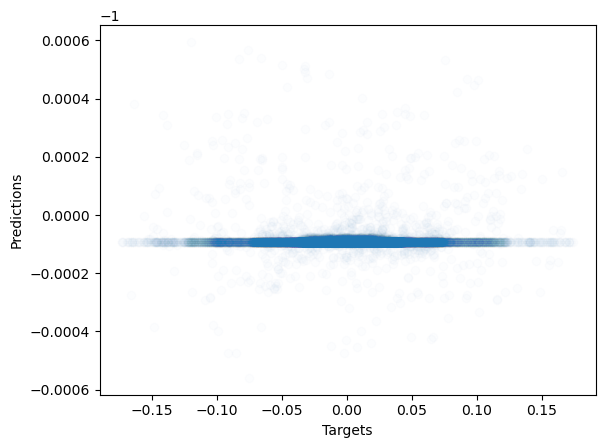

In [318]:
all_targets_y2 = [yuh[1] for yuh in all_batches_fix2]
print(len(all_targets_y2))
all_predictions_y2 = [yuh[1] for yuh in all_predictions2]
print(len(all_predictions_y2))
plt.scatter(all_targets_y2, all_predictions_y2, alpha = 0.01)
#plt.xlim(-.15, .15)
#plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

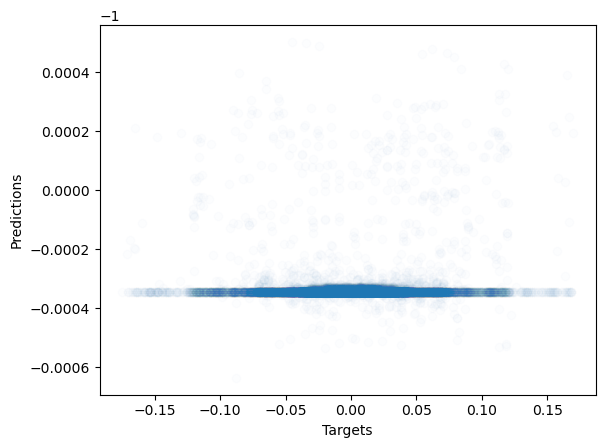

In [319]:
all_targets_z2 = [yuh[2] for yuh in all_batches_fix2]
print(len(all_targets_z2))
all_predictions_z2 = [yuh[2] for yuh in all_predictions2]
print(len(all_predictions_z2))
plt.scatter(all_targets_z2, all_predictions_z2, alpha = 0.01)
#plt.xlim(-.15, .15)
#plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [320]:
ball = get_sphere(3)
blankdataset = build_blank_dataset(ball, "softboi1")

testDataset = np.load(os.getcwd() + "/softboi1/npz_files/softboi1.npz")
xtestDataset = testDataset["fourier"]

predicts = model2(torch.Tensor(xtestDataset).float())
predicts[:50]

tensor([[-0.9999, -1.0002, -1.0002],
        [-0.9999, -0.9997, -1.0003],
        [-1.0002, -0.9995, -1.0003],
        [-0.9999, -1.0001, -1.0002],
        [-1.0003, -0.9997, -0.9997],
        [-1.0000, -1.0000, -0.9998],
        [-1.0001, -1.0003, -1.0001],
        [-0.9999, -1.0003, -1.0003],
        [-1.0000, -1.0001, -1.0001],
        [-1.0001, -0.9998, -0.9999],
        [-1.0000, -1.0000, -1.0002],
        [-1.0002, -1.0000, -1.0000],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
        [-0.9999, -1.0001, -1.0003],
 

In [321]:
yuh = generate_pred_mesh(predicts.detach().numpy(), ball)
yuh.show()

In [325]:
mesh2 = trimesh.load(os.getcwd() + '/meshes/Spikeyball2.stl')
mesh2.show()

In [326]:
dataset2, smooth2 = build_offset_dataset(mesh2, smooth_iter = 20000, lap_type = 'mesh', smooth_type = 'taubin')
smooth2.show()

In [327]:
blankdataset = build_blank_dataset(smooth2, "spikeboi2")

In [328]:
traindatax2 = torch.Tensor(dataset2["fourier"]).float()
traindatay2 = torch.Tensor(dataset2["target"]).float()

In [329]:
model3 = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=True,
    all_sine=True,
    skip=True,
    bn=True,
    dropout=0.0

)

In [330]:
trainingDataset2 = torch.utils.data.TensorDataset(traindatax2, traindatay2)

In [331]:
trainingLoad2 = torch.utils.data.DataLoader(trainingDataset2, batch_size = 1000, shuffle = True)

lossfunc2 = torch.nn.MSELoss()
optimizer2 = torch.optim.Adam(model2.parameters(), .0001)

In [332]:
all_predictions3 = []
all_batches3 = []

In [333]:
for i in range(10):
    for batch in trainingLoad2:
        
        optimizer2.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model2(Xbatch)
        #print(predicts)
        
        if i == 9:
            for a in predicts:
                print(a)
                all_predictions3.append(a.detach().numpy())
                
            all_batches3.append(Ybatch.detach().numpy())
        
        error = lossfunc2(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer2.step()

1.0014663
0.91717863
0.8149615
0.72604835
0.6376046
0.54759675
0.4701495
0.39584184
0.33581647
0.27010146
0.22711043
0.17848912
0.1432963
0.10327946
0.0792034
0.053487558
0.040815473
0.034918014
0.017312694
0.014984875
0.014109567
0.011580575
0.016611055
0.007771795
0.02148805
0.022980884
0.024911538
0.030027885
0.02703526
0.024827993
0.02487125
0.014958901
0.009656909
0.0065580453
0.008403108
0.014423287
0.011281702
0.014526911
0.009822138
0.014324769
0.007730868
0.0057830936
0.0074784188
0.008953268
0.010473048
0.005981411
0.006941273
0.02704042
0.0058040684
0.0078562945
0.0062604174
0.004102869
0.0049977857
0.0058071804
0.003901895
0.0022849152
0.00447725
0.0051606046
0.0063959556
0.0045912336
0.00553268
0.003825683
0.005593855
0.0059625995
0.0042149336
0.0036174157
0.00730037
0.0046620383
0.0029950745
0.0048710085
0.0052423715
0.0020016565
0.00418934
0.0040309574
0.0033837052
0.0036850036
0.0032400615
0.0028846427
0.0041330787
0.0029548642
0.002924116
0.0033922552
0.002285308
0.003

23042
(23042, 3)
23042


Text(0, 0.5, 'Predictions')

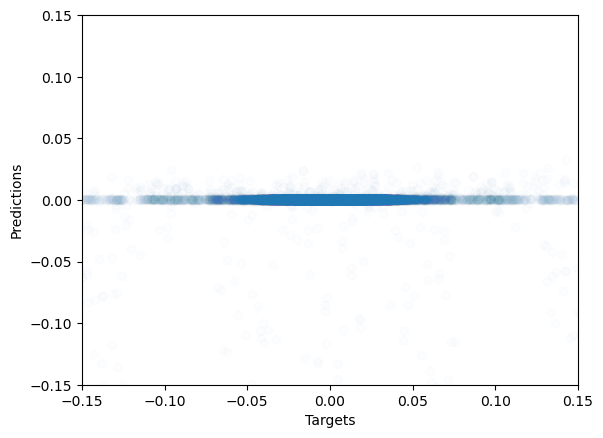

In [334]:
all_batches_fix3 = []
for i in all_batches3:
    for j in i:
        all_batches_fix3.append(j)

all_targets_x3 = [yuh[0] for yuh in all_batches_fix3]
#print(all_batches)
print(len(all_targets_x3))
all_predictions_x3 = [yuh[0] for yuh in all_predictions3]
print(np.array(all_predictions3).shape)
print(len(all_predictions_x3))
plt.scatter(all_targets_x3, all_predictions_x3, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

23042
23042


Text(0, 0.5, 'Predictions')

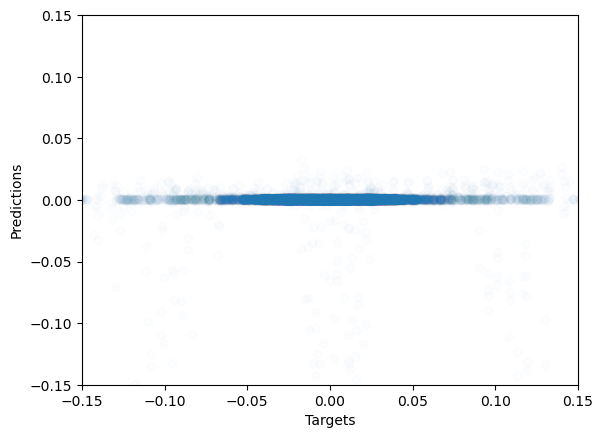

In [335]:
all_targets_y3 = [yuh[1] for yuh in all_batches_fix3]
print(len(all_targets_y3))
all_predictions_y3 = [yuh[1] for yuh in all_predictions3]
print(len(all_predictions_y3))
plt.scatter(all_targets_y3, all_predictions_y3, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [336]:
norms = []
cur_targets_y = []
for target in all_targets_y3:
    norms.append(np.linalg.norm(target))

eps = 0.05

points_to_plot = np.array(all_targets_y3)[np.where(np.array(norms) > eps)]
preds = np.array(all_predictions_y3)[np.where(np.array(norms) > eps)]

points_to_plot

array([-0.18164472,  0.06875876, -0.05251011, ...,  0.12143889,
        0.09482237,  0.1480798 ], dtype=float32)

Text(0, 0.5, 'Predictions')

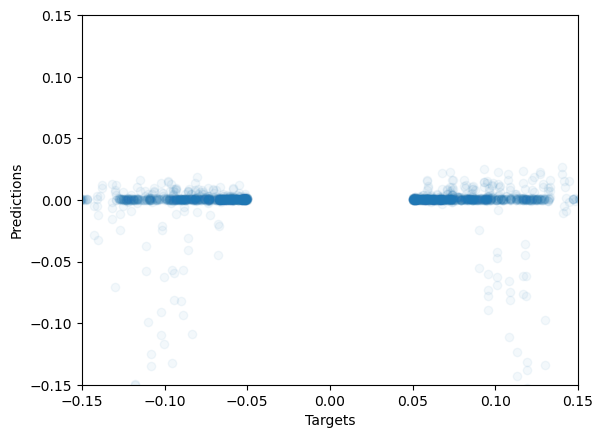

In [337]:
plt.scatter(points_to_plot, preds, alpha = 0.05)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

23042
23042


Text(0, 0.5, 'Predictions')

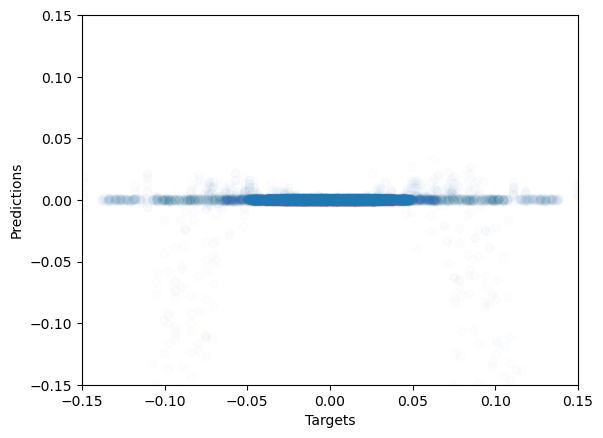

In [338]:
all_targets_z3 = [yuh[2] for yuh in all_batches_fix3]
print(len(all_targets_z3))
all_predictions_z3 = [yuh[2] for yuh in all_predictions3]
print(len(all_predictions_z3))
plt.scatter(all_targets_z3, all_predictions_z3, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [339]:
model4 = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=False,
    all_sine=False,
    skip=True,
    bn=True,
    dropout=0.0

)

In [340]:
trainingLoad2 = torch.utils.data.DataLoader(trainingDataset2, batch_size = 1000, shuffle = True)

lossfunc2 = torch.nn.MSELoss()
optimizer2 = torch.optim.Adam(model4.parameters(), .0001)

In [341]:
all_predictions4 = []
all_batches4 = []

In [342]:
for i in range(10):
    for batch in trainingLoad2:
        
        optimizer2.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model4(Xbatch)
        #print(predicts)
        
        if i == 9:
            for a in predicts:
                print(a)
                all_predictions4.append(a.detach().numpy())
                
            all_batches4.append(Ybatch.detach().numpy())
        
        error = lossfunc2(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer2.step()

1.0004323
0.91088337
0.81455195
0.71571386
0.6277669
0.54279083
0.4611285
0.39702943
0.32779413
0.26657096
0.21979128
0.17797488
0.13937669
0.10192944
0.07623691
0.057771757
0.03553959
0.02328389
0.022547571
0.013833745
0.012879483
0.010734898
0.014345329
0.021807287
0.020359816
0.02373074
0.02447843
0.027871188
0.029462166
0.025514761
0.022471743
0.017607452
0.009676213
0.0077841748
0.015148585
0.009092423
0.01229489
0.009770618
0.009786677
0.007239699
0.010235796
0.0073098843
0.004154284
0.0068712076
0.0092770085
0.011610936
0.0084717525
0.0038169536
0.006478087
0.005497432
0.0052784886
0.0045183883
0.006951602
0.005820904
0.0048523354
0.0023745992
0.0055820853
0.004870786
0.005078157
0.004896449
0.0038395652
0.0054300306
0.007518251
0.0028775348
0.0031240624
0.0024562886
0.00595369
0.0057154275
0.0046326215
0.0029496453
0.003089298
0.00091087574
0.00233376
0.0035318069
0.002151973
0.0028461001
0.0053607738
0.003020024
0.0026149908
0.0030209199
0.0026204025
0.002541826
0.0027855954
0

23042
(23042, 3)
23042


Text(0, 0.5, 'Predictions')

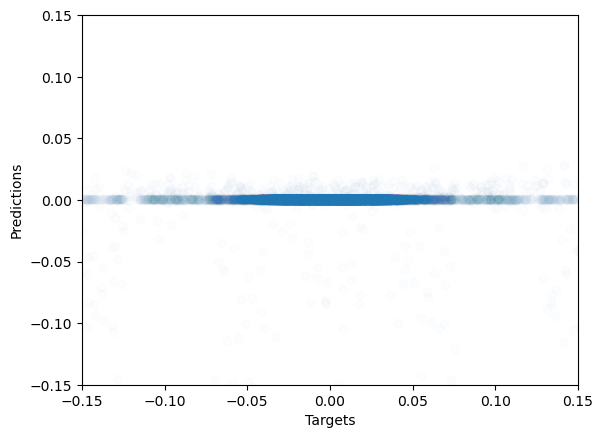

In [343]:
all_batches_fix4 = []
for i in all_batches4:
    for j in i:
        all_batches_fix4.append(j)

all_targets_x4 = [yuh[0] for yuh in all_batches_fix4]
#print(all_batches)
print(len(all_targets_x4))
all_predictions_x4 = [yuh[0] for yuh in all_predictions4]
print(np.array(all_predictions4).shape)
print(len(all_predictions_x4))
plt.scatter(all_targets_x4, all_predictions_x4, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

23042
23042


Text(0, 0.5, 'Predictions')

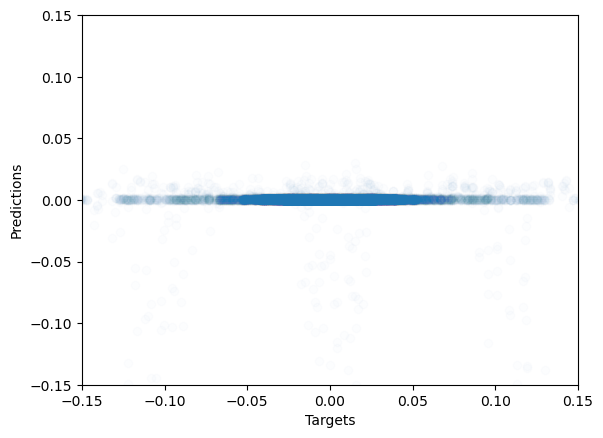

In [344]:
all_targets_y4 = [yuh[1] for yuh in all_batches_fix4]
print(len(all_targets_y4))
all_predictions_y4 = [yuh[1] for yuh in all_predictions4]
print(len(all_predictions_y4))
plt.scatter(all_targets_y4, all_predictions_y4, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

Text(0, 0.5, 'Predictions')

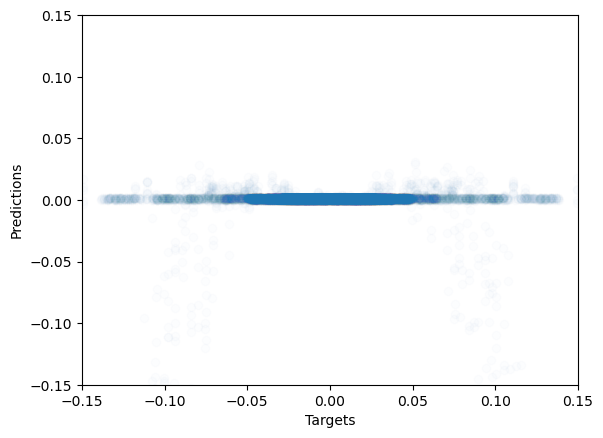

In [345]:
all_targets_z4 = [yuh[2] for yuh in all_batches_fix4]
#print(len(all_targets_z4))
all_predictions_z4 = [yuh[2] for yuh in all_predictions4]
#print(len(all_predictions_z4))
plt.scatter(all_targets_z4, all_predictions_z4, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

- X predictions and y predictions function
- Figuring out output prediction graphs that are wrong